# Agenda

## 1. [Introduction](#s1)

## 2. [OpenVINO™ Overview](#s6) - Kashchikhin

## 3. [OpenVINO™ Deep Learning Workbench](#s7) - Kashchikhin

## 4. [OpenVINO(TM) API](#s7) – Tugaryov

Object Detection sample: http://127.0.0.1:5665/jupyter/lab/tree/tutorials/object_detection_ssd/tutorial_object_detection_ssd.ipynb
W/o downloader and w/updated cells

## 5. [Practice](#s15) – Tugaryov

Task 1: apply pre-defined blur method to given image at inferred coordinates (photo with several faces)

Task 2: add blurring logic to pre-defined video processor

Task 3: replace each face on the photo with a smile with corresponding emotion

Task 4: emotional smile on the video

** Task 5: Telegram Bot - Smiler

# Intro

## Key Concepts
1. Neural Network

Artificial neural networks (ANNs) are comprised of a node layers, containing an input layer, one or more hidden layers, and an output layer. Each node, or artificial neuron, connects to another and has an associated weight and an activation function.

![](./pictures/neural_network.svg)

By Glosser.ca - Own work, [Link](https://commons.wikimedia.org/w/index.php?curid=24913461) CC BY-SA 3.0

2. Inference

Process of neural network execution: feeding data to the network and getting the results. 

3. Dataset

A dataset is a collection of data that can be treated by a neural network as a single unit for analytic and prediction purposes.

4. Optimization

To accelerate the inference of deep learning models by applying special methods without model retraining or fine-tuning, like post-training quantization.
The process of transforming the models that were trained in the floating-point precision into the models with integer representation with floating/fixed-point quantization operations between the layers.

5. Accuracy

Measure for how good or bad a neural network solves its task. Accuracy could be represented by different metrics depending on the task. 

6. Deployment

## Simple Workflow

![](./pictures/infer.PNG)

# OpenVINO

OpenVINO™ toolkit is a comprehensive toolkit for quickly developing applications and solutions that solve a variety of tasks including emulation of human vision, automatic speech recognition, natural language processing, recommendation systems, and many others. Based on latest generations of artificial neural networks, including Convolutional Neural Networks (CNNs), recurrent and attention-based networks, the toolkit extends computer vision and non-vision workloads across Intel® hardware, maximizing performance. It accelerates applications with high-performance, AI and deep learning inference deployed from edge to cloud.

## General Information

![](pictures/about_vino.png)

## OpenVINO capabilities

![](pictures/openvino_toolkit.png)

## OpenVINO tools

![](pictures/additional_tools.png)

## Fine-tuned and optimized OpenVINO models
### For various tasks

![](pictures/models.png)

# [Deep Learning Workbench In Depth](./dl_workbench.ipynb)

There you can find the DL WB interface examples and a sample workflow

## App - Face Replacer
Face detection, Emotion recognition

#### (INSERT) Picture before - picture after

### Plan
#### Part 0 - Obtain a model
0. Go to DL WB
1. Find a suitable face-detection model 
2. Experiment with it, optimize, assess results
3. Export\download the model

#### Part 1 - OpenVINO Python API + minimal app

Show tutorial_object_detection for OV Python API

4. Prerequisites
    * copy the model path from DL WB
    * sample data (video) is placed in the folder with this notebook
5. OpenVINO Python API for work with neural networks
6. Image/video pre-processing with OpenCV
7. Neural network execution - Inference
8. Results processing
    * Describe the model and its output so that it is understandable how to post-process
9. Have a video with faces replaced

#### Part 2 - Enriching/Building upon the app / Adding new functionality

9. Prepare another neural network
10. Integrate new network in the app

OR - give a choice of either following the presenter with deployment of continuing with the emotion recognition

#### Part 3 - Deploy the app
11. Prepare deployment package\bundle with model and download it
    * Ubuntu - go to DL WB
    * non-Ubuntu - supply with os-specific bundles
12. Prepare platform
    * Copy/download the necessary assets (OpenVINO deployment package, model)
    * Prepare environment using setupvars
13. Prepare sample\application and a Telegram bot
    * Clone the repository with the template
    * Copy your code from the notebook and integrate in the template
13. Deploy
14. Enjoy


#### Demo of the completed bot\application in case of the out of time

# OpenVINO™ API

The purpose of this tutorial is to examine a sample application that was created using the [Intel® Distribution of Open Visual Inference & Neural Network Optimization (OpenVINO™) toolkit](https://software.intel.com/openvino-toolkit). This tutorial will go step-by-step through the necessary steps to demonstrate object detection on images. Object detection is performed using a pre-trained network and running it using the Intel® Distribution of OpenVINO™ toolkit Inference Engine.

Object Detection in Computer Vision is a task of finding objects and locating them in the image.

The tutorial guides you through the following steps:

1. [Import required modules](#1.-Import-Required-Modules) 
3. [Configure inference: path to a model and other data](#3.-Configure-an-Inference)
4. [Initialize the OpenVINO™ runtime](#4.-Initialize-the-OpenVINO™-Runtime)
5. [Read the model](#5.-Read-the-Model)
6. [Make the model executable](#6.-Make-the-Model-Executable)
7. [Prepare an image for model inference](#7.-Prepare-an-Image-for-Model-Inference)
8. [Infer the model](#8.-Infer-the-Model)
9. [Show predictions](#9.-Show-Predictions)

### 1. Import Required Modules

Import the Python* modules that you will use in the sample code:
- [pathlib](https://docs.python.org/3/library/os.html#module-os) is a standard Python module used for filename parsing.
- [cv2](https://docs.opencv.org/trunk/) is an OpenCV module used to work with images.
- [NumPy](http://www.numpy.org/) is an array manipulation module used to process images as arrays.
- [OpenVINO Inference Engine](https://docs.openvinotoolkit.org/latest/openvino_docs_IE_DG_Deep_Learning_Inference_Engine_DevGuide.html) is an OpenVINO™ Python API module used for inference.
- [IPython](https://ipython.readthedocs.io/en/stable/index.html) is an IPython API uused for showing images and videos in the notebook

Run the cell below to import the modules. 

In [1]:
import os
import cv2
import numpy as np
from openvino.inference_engine import IECore
from IPython.display import HTML, Image, display

### 2. Configure an Inference

Once you have the OpenVINO™ IR of your model, you can start experimenting with it by inferring it and inspecting its output. 

> **NOTE**: Copy the paths to the `.xml` and `.bin` files from the DL Workbench UI and paste them below.
#### Required parameters

Parameter| Explanation
---|---
**model_xml**| Path to the `.xml` file of OpenVINO™ IR of your model
**model_bin**| Path to the `.bin` file of OpenVINO™ IR of your model

In [2]:
# Model IR files
face_detection_model_xml = 'data/models/face-detection-adas-0001.xml'
face_detection_model_bin = 'data/models/face-detection-adas-0001.bin'

#### Optional Parameters

Experiment with optional parameters after you go the full workflow of the tutorial.

Parameter| Explanation
---|---
**input_image_path**| Path to an input image. Use the `car.bmp` image placed in the directory of the notebook or, if you have imported a dataset in the DL Workbench, copy the path to an image in the dataset.
**device**| Specify the [target device](https://docs.openvinotoolkit.org/latest/workbench_docs_Workbench_DG_Select_Environment.html) to infer on: CPU, GPU, or MYRIAD. Note that the device must be present. For this tutorial, use `CPU` which is known to be present.
**prob_threshold**| Probability threshold to filter detection results

In [3]:
# Input image file. 
input_image_path = 'data/input_image.JPG'

# Input video file
input_video_path = 'data/input.mp4'

# Output video file
output_video_path = 'data/output.mp4'

# Device to use
device = 'CPU'

# Minimum percentage threshold to detect an object
prob_threshold = 50

print(
f'''Configuration parameters settings:
    model_xml={face_detection_model_xml},
    model_bin={face_detection_model_bin},
    input_image_path={input_image_path},
    device={device}, 
    prob_threshold={prob_threshold}''',
)

Configuration parameters settings:
    model_xml=data/models/face-detection-adas-0001.xml,
    model_bin=data/models/face-detection-adas-0001.bin,
    input_image_path=data/input_image.JPG,
    device=CPU, 
    prob_threshold=50


### 3. Initialize the OpenVINO™ Runtime

Once you define the parameters, let's initiate the `IECore` object that accesses OpenVINO™ runtime capabilities.

In [4]:
# Create an Inference Engine instance
ie_core = IECore()

### 4. Read the Model

Put the IR of your model in the memory.

In [5]:
# Read the network from IR files
face_detection_network = ie_core.read_network(model=face_detection_model_xml, weights=face_detection_model_bin)

### 5. Make the Model Executable

Reading a network is not enough to start a model inference. The model must be loaded to a particular abstraction representing a particular accelerator. In OpenVINO™, this abstraction is called *plugin*. A network loaded to a plugin becomes executable and will be inferred in one of the next steps. 

After loading, we keep necessary model information such as names of input and output blobs: `input_blob` and `output_blob`. Let's remember the input dimensions of your model:
- `n` - input batch size
- `c` - number of input channels. Often, it is `1` or `3`, which means that the model expects either a grayscale or a color image.
- `h` - input image height
- `w` - input image width

In [6]:
# Store names of input and output blobs
face_detection_input_blob = next(iter(face_detection_network.input_info))
face_detection_output_blob = next(iter(face_detection_network.outputs))

# Read the input dimensions: n=batch size, c=number of channels, h=height, w=width
face_detection_network_input_shape = face_detection_network.input_info[face_detection_input_blob].input_data.shape
face_detection_input_batch, face_detection_input_channels, face_detection_input_height, face_detection_input_width = face_detection_network_input_shape
print(f'Face Detection model input dimensions: n={face_detection_input_batch}, c={face_detection_input_channels}, h={face_detection_input_height}, w={face_detection_input_width}')

Face Detection model input dimensions: n=1, c=3, h=384, w=672


## 6. Load the model to the device
>NOTE: need documentation 

In [7]:
print(f'Loaded the model into the Inference Engine for the {device} device.'), 
face_detection_executable_network = ie_core.load_network(network=face_detection_network, device_name=device)

Loaded the model into the Inference Engine for the CPU device.


### 6. Prepare an Image for Model Inference

Now let's read and prepare the input image by resizing and re-arranging its dimensions according to the input dimensions of the model.

In [8]:
# Define the function to load the input image
def load_input_image(input_path):   
    # Use OpenCV to load the input image
    image = cv2.imread(input_path)
    return image

# Define the function to pre-process (resize, transpose, ) the input image
def pre_process_input_image(image: np.ndarray, target_height: int, target_width: int) -> np.ndarray:
    # Resize the image dimensions from image to model input w x h
    resized_image = cv2.resize(image, (target_width, target_height))
    # Change data layout from HWC to CHW
    transposed_image = resized_image.transpose((2, 0, 1))  
    # Reshape to input dimensions
    
    n = 1 # Batch is always 1 in our case
    c = 3 # Channels is always 3 in our case
    
    reshaped_image = transposed_image.reshape((n, c, target_height, target_width))
    return reshaped_image

def show_images(image: np.ndarray):
    _, data = cv2.imencode('.jpg', image) 
    image = Image(data=data)
    display(image)

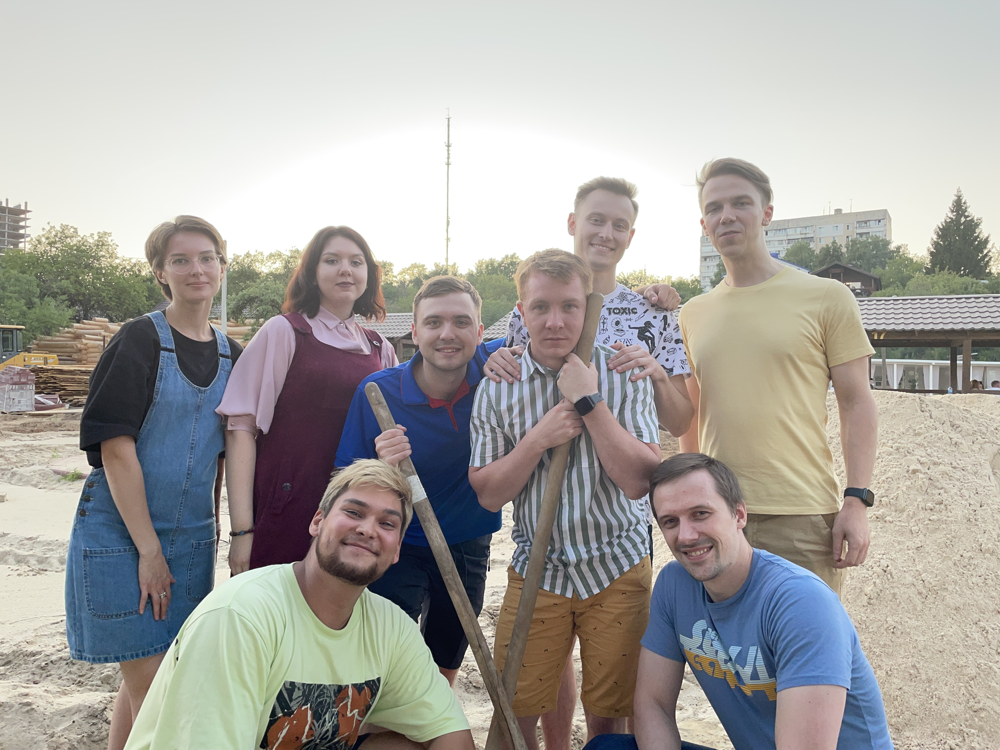

In [9]:
# Use OpenCV to load the input image
original_image = cv2.imread(input_image_path)

# Prepare the image
input_frame = pre_process_input_image(original_image, target_height=face_detection_input_height, target_width=face_detection_input_width)

# Display the input image
show_images(original_image)

In [15]:
face_detection_inference_results = face_detection_executable_network.infer(
    inputs={
        face_detection_input_blob: input_frame
    }
)

face_detection_inference_results = face_detection_inference_results[face_detection_output_blob]

### 7. Show Predictions

The next step is to parse the inference results and draw boxes over the objects detected in the image.

A result of model inference (`face_detection_inference_results`) is an array of predictions. Each prediction `object` has a following structure:

- `object[2]`: Confidence level that currently detected object is an instance of the predicted class
- `object[3]`: lower x coordinate of the detected object 
- `object[4]`: lower y coordinate of the detected object
- `object[5]`: upper x coordinate of the detected object
- `object[6]`: upper y coordinate of the detected object

In [16]:
def parse_face_detection_results(inference_results: np.ndarray, original_image_width: int, original_image_height: int) -> list:
    detected_faces = []
    
    for inference_result in inference_results[0][0]:
        confidence = round(inference_result[2] * 100, 1)

        # If confidence is more than the specified threshold, draw and label the box 
        if confidence > prob_threshold:

            # Get coordinates of the box containing the detected object
            xmin = int(inference_result[3] * original_image_width)
            ymin = int(inference_result[4] * original_image_height)
            xmax = int(inference_result[5] * original_image_width)
            ymax = int(inference_result[6] * original_image_height)

            detected_face = (xmin, ymin, xmax, ymax, confidence)
            detected_faces.append(detected_face)
            
    return detected_faces

In [17]:
# Function to process inference results
def post_process_face_detection(inference_results: np.ndarray, original_image: np.ndarray) -> np.ndarray:
    original_image_height, original_image_width, *_ = original_image.shape
    
    processed_image = original_image.copy()
    
    # Get output results
    color = (12.5, 255, 255)
    
    detected_faces = parse_face_detection_results(inference_results, original_image_width, original_image_height)
    # Loop through all possible results
    for detected_face in detected_faces:
        xmin, ymin, xmax, ymax, confidence = detected_face

        # Draw the box and label for the detected object
        cv2.rectangle(processed_image, (xmin, ymin), (xmax, ymax), color, 4)
        cv2.putText(processed_image, 
                    f'{confidence} %', (xmin, ymin - 7), 
                    cv2.FONT_HERSHEY_COMPLEX, 1, color, 2)
            
    return processed_image

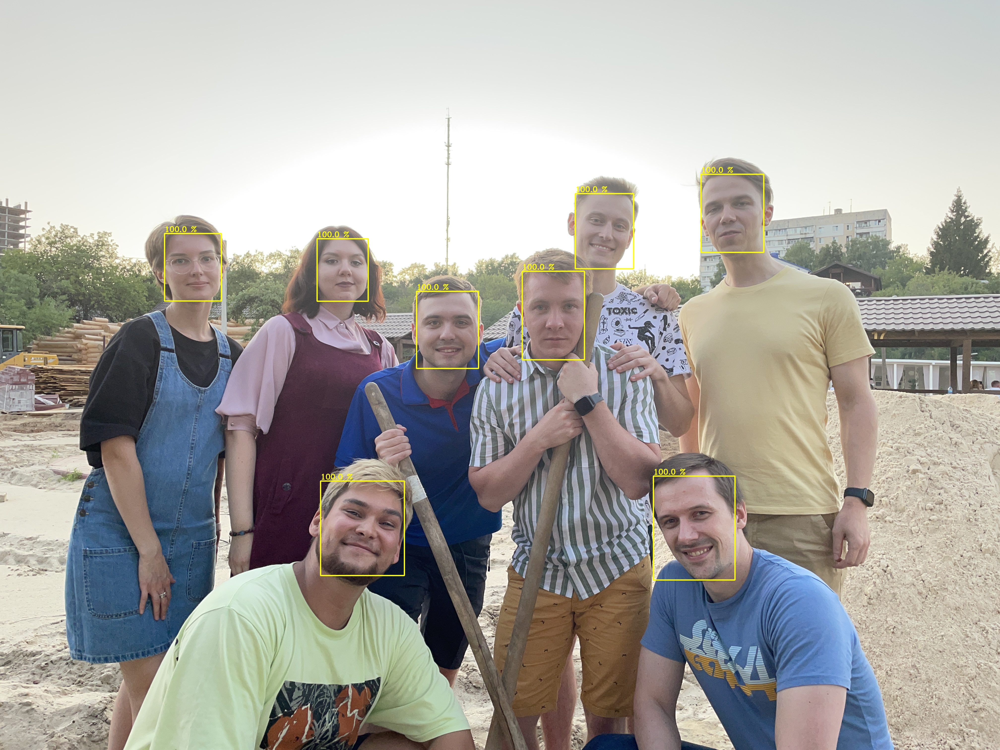

In [18]:
processed_image = post_process_face_detection(face_detection_inference_results, original_image)

show_images(processed_image)

# Practice

## Task 1: Apply pre-defined blur method to given image at inferred coordinates

Define a function to blur an image

In [19]:
def blur(image: np.ndarray) -> np.ndarray:
    height, width = image.shape[:2]
    pixels_count = 16
    temp = cv2.resize(image, (pixels_count, pixels_count), interpolation=cv2.INTER_LINEAR)
    return cv2.resize(temp, (width, height), interpolation=cv2.INTER_NEAREST)

And one more function to process inference results of the face detection network. Use the `blur` function to blur a part of image with a face

In [20]:
def blur_postprocessing(face_detection_inference_result: np.ndarray, original_image: np.ndarray) -> np.ndarray:
    original_image_height, original_image_width,  _ = original_image.shape
    processed_image = original_image.copy()
    for detected_face in face_detection_inference_result[0][0]:
        confidence = round(detected_face[2] * 100, 1)

        # If confidence is more than the specified threshold, draw and label the box 
        if confidence > prob_threshold:

            # Get coordinates of the box containing the detected object
            xmin = int(detected_face[3] * original_image_width)
            ymin = int(detected_face[4] * original_image_height)
            xmax = int(detected_face[5] * original_image_width)
            ymax = int(detected_face[6] * original_image_height)

            face = original_image[ymin:ymax, xmin:xmax]
            processed_image[ymin:ymax, xmin:xmax] = blur(face)
    return processed_image

And now prepare a function to do inference. This function must prepare image for inference (use `pre_process_input_image` for this) and run inference of the image using  `face_detection_executable_network`

In [102]:
def face_detection_indeference(image: np.ndarray)-> np.ndarray:
    # 1. Prepare the image
    input_frame = pre_process_input_image(image, target_width=face_detection_input_width, target_height=face_detection_input_height)

    # 2. Infer the model
    face_detection_inference_results = face_detection_executable_network.infer(inputs={face_detection_input_blob: input_frame})  
    return face_detection_inference_results[face_detection_output_blob]

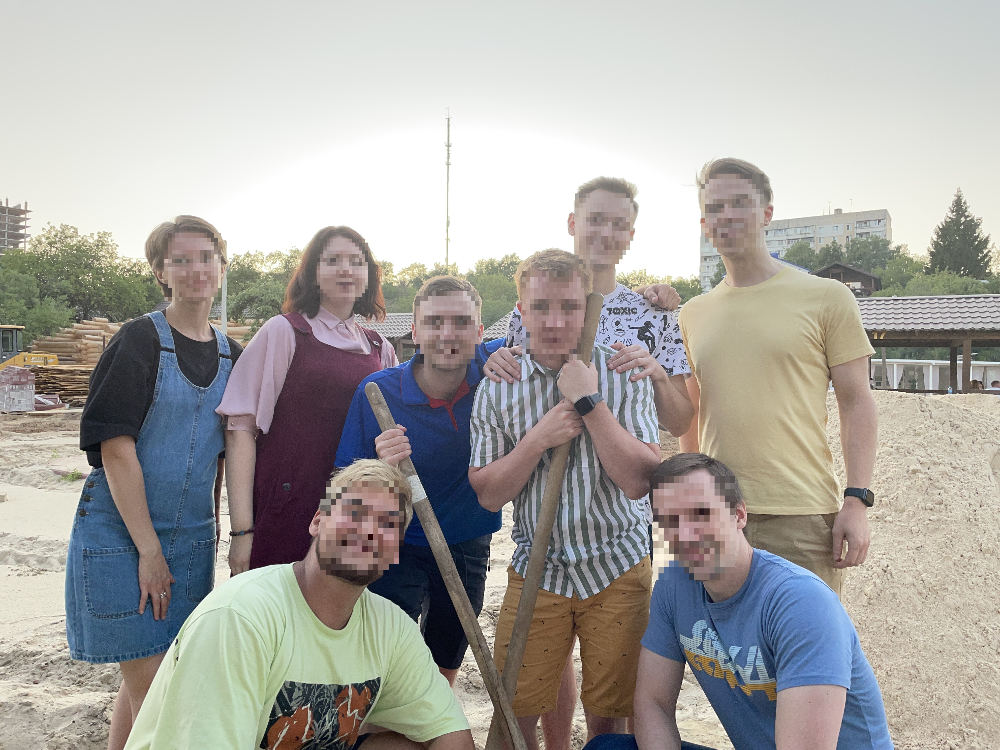

In [103]:
inference_result = face_detection_indeference(original_image)

# 3. Blur faces on image
processed_image = blur_postprocessing(inference_result, original_image)

show_images(processed_image)

## Task 2: Add blurring logic to pre-defined video processor

In [ ]:
Inference of single image is done and the next task is process all frames of a video.

In [22]:
input_video_stream = cv2.VideoCapture(input_video_path)

In [88]:
def prepare_output_video_stream(input_video_stream: cv2.VideoCapture, output_video_file_path: str) -> cv2.VideoWriter:
    width  = int(input_video_stream.get(3))
    height = int(input_video_stream.get(4))
    video_writer = cv2.VideoWriter(output_video_file_path, cv2.VideoWriter_fourcc(*'avc1'), 20, (width, height))
    return video_writer

output_video_stream = prepare_output_video_stream(input_video_stream, output_video_path)

In [24]:
def face_detection_indeference(image: np.ndarray)-> np.ndarray:
    input_frame = pre_process_input_image(image, target_width=face_detection_input_width, target_height=face_detection_input_height)

    # 2. Infer the model
    face_detection_inference_results = face_detection_executable_network.infer(inputs={face_detection_input_blob: input_frame})  
    return face_detection_inference_results[face_detection_output_blob]

In [25]:
while input_video_stream.isOpened():
    # 1. Read the next frame from the input video 
    return_code, original_frame = input_video_stream.read()
    if not return_code:
        break
        
    inference_result = face_detection_indeference(original_frame)

    # 3. Blur faces on image
    processed_image = blur_postprocessing(inference_result, original_frame)
    
    # 3. Write the resulting frame to the output stream
    output_video_stream.write(processed_image)
    

input_video_stream.release()
# Save the resulting video
output_video_stream.release()

In [26]:
# Show a source video
HTML(f"""<video width="600" height="400" controls><source src="{output_video_path}" type="video/mp4"></video>""")

## Task 3: replace each face on the photo with a smile with corresponding emotion

### Step 1: Download a Pretrained Model from the Open Model Zoo

OpenVINO™ toolkit includes the [Model Optimizer](http://docs.openvinotoolkit.org/latest/_docs_MO_DG_Deep_Learning_Model_Optimizer_DevGuide.html) used to convert and optimize trained models into Intermediate Representation (IR) model files, and the [Inference Engine](http://docs.openvinotoolkit.org/latest/_docs_IE_DG_Deep_Learning_Inference_Engine_DevGuide.html), which uses the IR model files to run an inference on hardware devices. The IR model files are created from models trained in popular frameworks, like Caffe\*, TensorFlow\*, and others. 

OpenVINO™ [Model Downloader](http://docs.openvinotoolkit.org/latest/_tools_downloader_README.html) downloads common inference models from the [Intel® Open Model Zoo](https://github.com/opencv/open_model_zoo). 

Let's download the `emotions-recognition-retail-0003` model first.

In [32]:
!python3 ~/intel/openvino_2021/deployment_tools/open_model_zoo/tools/downloader/downloader.py --name emotions-recognition-retail-0003 --precision FP16 --output_dir data/model
!mv data/model/intel/emotions-recognition-retail-0003/FP16/emotions-recognition-retail-0003.* data/models/

################|| Downloading emotions-recognition-retail-0003 ||################

========== Downloading data/model/intel/emotions-recognition-retail-0003/FP16/emotions-recognition-retail-0003.xml
... 100%, 39 KB, 1463 KB/s, 0 seconds passed

========== Downloading data/model/intel/emotions-recognition-retail-0003/FP16/emotions-recognition-retail-0003.bin
... 100%, 4848 KB, 7050 KB/s, 0 seconds passed



In [27]:
# Model IR files
emotion_recognition_model_xml = 'data/models/emotions-recognition-retail-0003.xml'
emotion_recognition_model_bin = 'data/models/emotions-recognition-retail-0003.bin'

In [28]:
# call ie_core.read_network to read the OpenVINO IR model
emotion_recognition_network = ie_core.read_network(emotion_recognition_model_xml, emotion_recognition_model_bin)

### Step 3: Load the network to a device

Use the instance of `IECore`.
The class `IECore` has a special function called `load_network`, which loads a network to a device.
This function prepares the network for the first inference on the device 
and returns an instance of the network prepared for an inference (execution). 
This function has many parameters, but in this case, you need to know only about two of them:
* `network` - instance of `IENetwork`
* `device_name` - string, contains a device name to infer a model on: CPU, GPU and so on.

In [29]:
emotion_recognition_network_loaded_on_device = ie_core.load_network(emotion_recognition_network, device)

### Step 4: Open the input video

In [30]:
input_video_stream = cv2.VideoCapture(input_video_path)

### Step 5: Create an output video stream

In [33]:
output_video_stream = prepare_output_video_stream(input_video_stream, output_video_path)

In [34]:
emotion_recognition_input_layer = next(iter(emotion_recognition_network.input_info))
emotion_recognition_input_blob = emotion_recognition_network.input_info[emotion_recognition_input_layer].input_data

print(f'Input layer of the emotions-recognition-retail-0003 is {emotion_recognition_input_layer}')

Input layer of the emotions-recognition-retail-0003 is data


In [35]:
emotion_recognition_input_batch, emotion_recognition_input_channels, emotion_recognition_input_height, emotion_recognition_input_width = emotion_recognition_input_blob.shape

print(f'Input shape of the emotion recognition network is n={emotion_recognition_input_batch}, c={emotion_recognition_input_channels}, h={emotion_recognition_input_height}, w={emotion_recognition_input_width}')

Input shape of the emotion recognition network is n=1, c=3, h=64, w=64


In [36]:
emotion_recognition_output_layer = next(iter(emotion_recognition_network.outputs))

### Step 6: Prepare a frame and run inference

In [37]:
def emotion_recognition_inference(face_frame: np.ndarray):
    prepared_frame = pre_process_input_image(face_frame, target_width=emotion_recognition_input_width, target_height=emotion_recognition_input_height)
    
    # Run the inference how you did it early
    inference_results = emotion_recognition_network_loaded_on_device.infer({
        emotion_recognition_input_layer: prepared_frame
    })
    
    # For understanding what is the result of inference this model, check documentation 
    # https://docs.openvinotoolkit.org/latest/_models_intel_emotions_recognition_retail_0003_description_emotions_recognition_retail_0003.html
    return inference_results[emotion_recognition_output_layer]

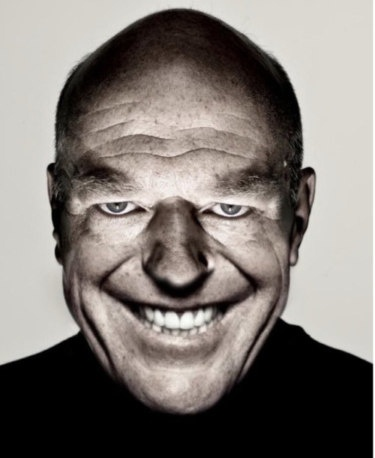

Inference results:
neutral:	0.015062976628541946
happy:	0.9605486989021301
sad:	0.0048506311140954494
surprise:	0.018261076882481575
anger:	0.0012766160070896149


In [38]:
original_frame = load_input_image('./data/emotion.jpg')

# 2. Infer the model
face_detection_inference_results = emotion_recognition_inference(original_frame)

face_detection_inference_result = face_detection_inference_results.flatten()
emotions = ['neutral', 'happy', 'sad', 'surprise', 'anger']

show_images(original_frame)

print('Inference results:')
for index, prediction in enumerate(face_detection_inference_result):
    emotion = emotions[index]
    print(f'{emotion}:\t{prediction}')

### Step 16: Drow boxes and emotions in a frame

Input image:


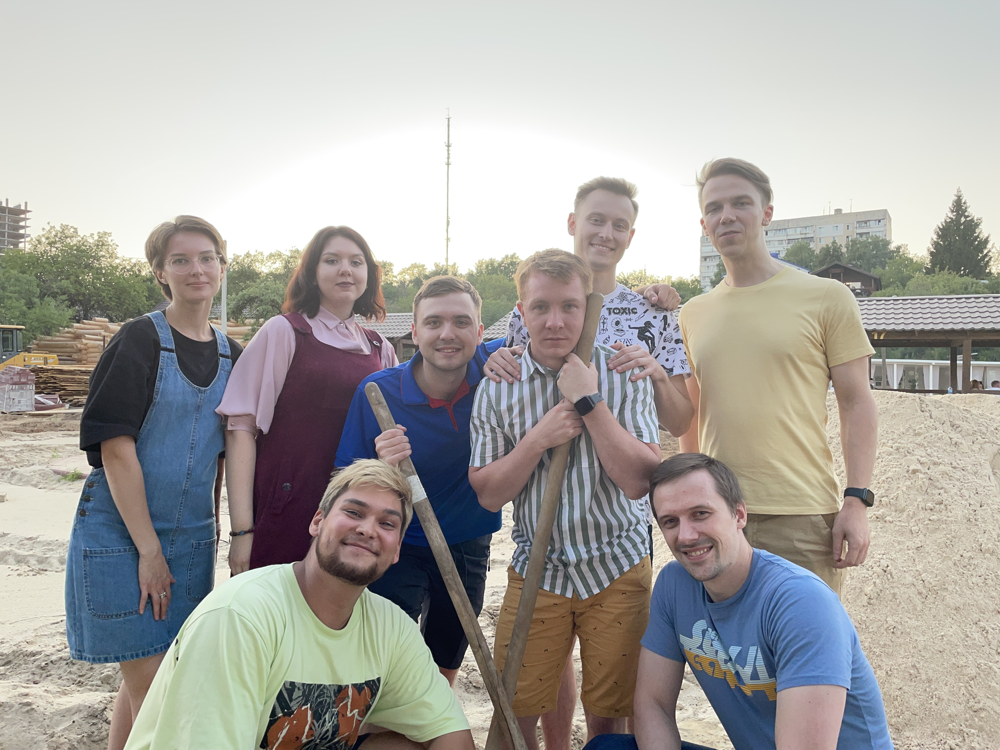

In [67]:
# Load the image
original_image = load_input_image(input_image_path)
original_image_height, original_image_width, *_ = original_image.shape

# Display the input image
print("Input image:")
show_images(original_image)

In [39]:
def get_smile_by_index(emotion_inference_result: np.ndarray) -> np.ndarray:
    emotions = ['neutral', 'happy', 'sad', 'surprise', 'anger']
    emotion_index = np.argmax(emotion_inference_result.flatten()) 
    smile_path = f'./data/{emotions[emotion_index]}.png'
    return cv2.imread(smile_path, -1)

In [75]:
def emotion_recognition_inference_postprocess(image: np.ndarray, recognized_emotions: np.ndarray, xmin:int, xmax:int, ymin:int, ymax:int):
    # Put the title to a frame
    width = xmax - xmin
    height = ymax - ymin
    
    smile = get_smile_by_index(recognized_emotions)
    resized_smile = cv2.resize(smile, (width, height))

    alpha_s = resized_smile[:, :, 3] / 255.0
    alpha_l = 1.0 - alpha_s
    for c in range(0, 3):
        image[ymin:ymax, xmin:xmax, c] = (alpha_s * resized_smile[:, :, c] + alpha_l * image[ymin:ymax, xmin:xmax, c])


In [76]:
processed_image = original_image.copy()
face_detection_inference_results = face_detection_indeference(original_image)
original_image_height, original_image_width, _ = original_image.shape

faces_coordinates = parse_face_detection_results(face_detection_inference_results, original_image_width, original_image_height)

for face_coordinates in faces_coordinates:
    xmin, ymin, xmax, ymax, confidence = face_coordinates
    face = original_image[ymin:ymax, xmin:xmax]

    emotion_predictions = emotion_recognition_inference(face) # ...
    
    emotion_recognition_inference_postprocess(processed_image, emotion_predictions, xmin, xmax, ymin, ymax) # ...

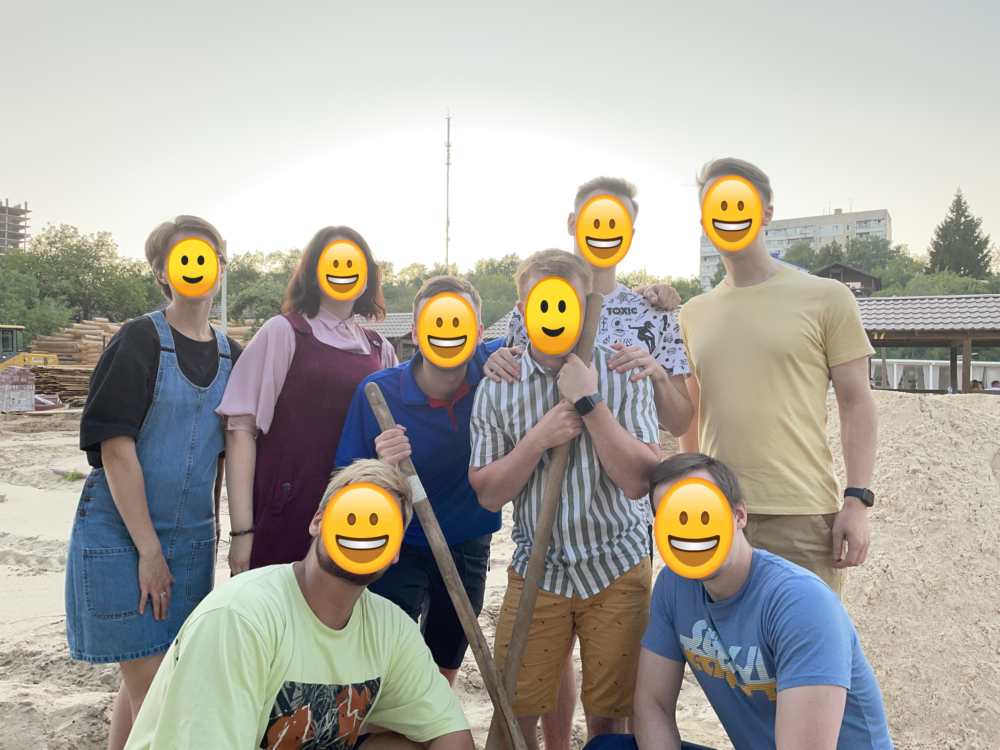

In [77]:
show_images(processed_image)

### Step 17: Loop over frames in the input video

In [97]:
input_video_stream = cv2.VideoCapture(input_video_path)

In [98]:
output_video_stream = prepare_output_video_stream(input_video_stream, output_video_path)

In [99]:
while input_video_stream.isOpened():
    # 1. Read the next frame from the input video 
    finish, original_frame = input_video_stream.read()
    if not finish:
        break
        
    # 2. apply face replacement from previous step
    face_detection_inference_results = face_detection_indeference(original_frame)
    original_image_height, original_image_width, _ = original_frame.shape
    faces_coordinates = parse_face_detection_results(face_detection_inference_results, original_image_width, original_image_height)

    for face_coordinates in faces_coordinates:
        xmin, ymin, xmax, ymax, confidence = face_coordinates
        face = original_frame[ymin:ymax, xmin:xmax]

        emotion_predictions = emotion_recognition_inference(face) # ...

        emotion_recognition_inference_postprocess(original_frame, emotion_predictions, xmin, xmax, ymin, ymax) # ...
    # 3. Write the resulting frame to the output stream
    output_video_stream.write(original_frame)
    
input_video_stream.release()
# Save the resulting video
output_video_stream.release()

In [100]:
# Show a source video
HTML(f"""<video width="600" height="400" controls><source src="{output_video_path}" type="video/mp4"></video>""")